In [1]:
import tensorflow as tf
import pandas as pd
import numpy as np
from surrogate import rules

from utils.df_loader import load_adult_df, load_compas_df, load_german_df, load_diabetes_df, load_breast_cancer_df
from utils.preprocessing import preprocess_df, label_decode
from sklearn.model_selection import train_test_split
from utils.dice import generate_dice_result, process_results
from utils.models import train_three_models, evaluation_test, save_three_models, load_three_models
from utils.save import save_result_as_csv
from IPython.display import Image
import PIL
import pydotplus
from six import StringIO
from sklearn.tree import export_graphviz
from pydotplus import *


pd.options.mode.chained_assignment = None 

print('TF version: ', tf.__version__)
print('Eager execution enabled: ', tf.executing_eagerly()) # False

seed = 123
tf.random.set_seed(seed)
np.random.seed(seed)


TF version:  2.0.0
Eager execution enabled:  True


In [2]:
def get_location(scaler, col):
    if col in scaler.feature_names_in_:
        return np.where(scaler.feature_names_in_ == col)[0]
    
    else:
        raise Exception(f"Column [{col}] not a feature in this scaler, scaler features: {scaler.feature_names_in_}")


def get_scaled_value(scaler, col, X):
    loc=get_location(scaler, col)

    X *= scaler.scale_[loc]
    X += scaler.min_[loc]

    if scaler.clip:
        np.clip(X, scaler.feature_range[0][loc], scaler.feature_range[1][loc], out=X)
    
    return X[0]


def get_original_value(scaler, col, X):
    loc = get_location(scaler, col)

    X -= scaler.min_[loc]
    X /= scaler.scale_[loc]

    return X[0]

In [3]:

# VISUALISE_DECISION_TREE_PATH
# 
def visualize_decision_tree_path( clf, graph, instance, indx, exp_type, path ):  

  for i, node in enumerate(graph.get_node_list()):
    if node.get_attributes().get('label') is None:
        continue

    if 'samples = ' in node.get_attributes()['label']:
        labels = node.get_attributes()['label'].split('<br/>')
        for i, label in enumerate(labels):
            if label.startswith('samples = '):
                labels[i] = 'samples = 0'
        node.set('label', '<br/>'.join(labels))
        node.set_fillcolor('white')
    
    lable_str = node.get_attributes()['label']  
    feature_value_str = (lable_str.split("<br/>")[0]).replace('<','')
    feature_name = feature_value_str.split(" ")[0]
    if feature_name in df_info.scaler.feature_names_in_:
      feature_value = float(feature_value_str.split(" ")[-1])
      original_value = get_original_value(df_info.scaler, feature_name , feature_value)
      #print(f"name: {feature_name}. value: {feature_value}, original_value: {original_value}")
      original_lable_str = lable_str.replace(feature_value_str, ' '.join([*(feature_value_str.split(' '))[:-1],f'{original_value:.2f}']))
      node.set('label', original_lable_str)
    #raise StopIteration()

  samples = instance
  
  decision_paths = clf.decision_path( [samples] )

  for decision_path in decision_paths:
    for n, node_value in enumerate(decision_path.toarray()[0]):
      if node_value == 0:
        continue
      node = graph.get_node(str(n))[0]            
      node.set_fillcolor('green')
      labels = node.get_attributes()['label'].split('<br/>')
      for i, label in enumerate(labels):
        if label.startswith('samples = '):
          labels[i] = 'samples = {}'.format(int(label.split('=')[1]) + 1)
      
      node.set('label', '<br/>'.join(labels))

  filename = path
  graph.write_png(filename)

  im = PIL.Image.open(filename)
  return im


# EXTRACT_DECISION_PATH
# 
def extract_decision_path(clf, graph, instance ):

  #samples = instance['scaled_vector']
  #decision_paths = clf.decision_path( [samples] )
  samples = instance
  decision_paths = clf.decision_path( [samples] )

  for decision_path in decision_paths:
    path = []
    for n, node_value in enumerate(decision_path.toarray()[0]):
      if node_value == 0:
        continue

      node = graph.get_node(str(n))[0]
      labels = node.get_attributes()['label'].split('<br/>')
      labels.pop(1)
      try:
        labels.remove("samples = 1")
        labels.remove("samples = 0")
        labels.remove("gini = 0.0")
      except ValueError:
        labels
      path.append(labels)
  return path

def export_decision_tree(clf, class_names, DATASET_NAME, path):
  dot_data = StringIO()
  export_graphviz(clf, out_file=dot_data,  
                  filled=True, rounded=True,
                  special_characters=True, feature_names = feature_names,
                  class_names=class_names)

  # convert to png format
  graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
  graph.write_png(path)
  return graph


In [4]:
#### Select dataset ####'

dataset_name = 'diabetes' # [adult, german, compas]

if dataset_name == 'adult':
    dataset_loading_fn = load_adult_df
elif dataset_name == 'german':
    dataset_loading_fn = load_german_df
elif dataset_name == 'compas':
    dataset_loading_fn = load_compas_df
elif dataset_name == 'diabetes':
    dataset_loading_fn = load_diabetes_df
elif dataset_name == 'breast_cancer':
    dataset_loading_fn = load_breast_cancer_df
else:
    raise Exception("Unsupported dataset")

In [5]:
#pip install pillow
#pip install dtreeviz
#pip install Graphviz
from dtreeviz.trees import *
from sklearn.tree import DecisionTreeClassifier
dice_dt = pd.read_csv(r'./datasets/eval_dice_diabetes_dt_result.csv')


In [6]:
dice_dt

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,scaled_input_Pregnancies,scaled_input_Glucose,scaled_input_BloodPressure,scaled_input_SkinThickness,scaled_input_Insulin,scaled_input_BMI,scaled_input_DiabetesPedigreeFunction,...,running_time,Found,ground_truth,prediction,L1,L2,Sparsity,Realistic,MAD,Mahalanobis
0,0.0,0.0,0.0,0.411765,0.909548,0.688525,0.212121,0.226950,0.535022,0.216909,...,0.023972,Y,Y,Y,0.211955,0.211955,1.00,True,0.304294,0.024904
1,1.0,0.0,0.0,0.411765,0.909548,0.688525,0.212121,0.226950,0.535022,0.216909,...,0.022937,Y,Y,Y,0.596733,0.425213,2.00,True,0.739724,0.063616
2,2.0,0.0,0.0,0.411765,0.909548,0.688525,0.212121,0.226950,0.535022,0.216909,...,0.021940,Y,Y,Y,1.260928,0.918983,2.00,True,1.305758,0.165579
3,3.0,0.0,0.0,0.411765,0.909548,0.688525,0.212121,0.226950,0.535022,0.216909,...,0.021993,Y,Y,Y,0.860928,0.611740,2.00,True,0.943377,0.107597
4,4.0,0.0,0.0,0.411765,0.909548,0.688525,0.212121,0.226950,0.535022,0.216909,...,0.023970,Y,Y,Y,1.233013,0.899540,2.00,True,1.627747,0.127524
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,96.0,19.0,0.0,0.000000,0.502513,0.721311,0.606061,0.130024,0.697466,0.377455,...,0.021942,Y,N,N,1.520631,1.086375,2.00,True,1.597737,0.170394
97,97.0,19.0,0.0,0.000000,0.502513,0.721311,0.606061,0.130024,0.697466,0.377455,...,0.022941,Y,N,N,0.066563,0.066563,1.00,True,0.065752,0.010694
98,98.0,19.0,0.0,0.000000,0.502513,0.721311,0.606061,0.130024,0.697466,0.377455,...,0.022903,Y,N,N,0.627237,0.450628,2.00,True,0.832328,0.063692
99,99.0,19.0,0.0,0.000000,0.502513,0.721311,0.606061,0.130024,0.697466,0.377455,...,0.021942,Y,N,N,0.393921,0.393921,1.00,True,0.389122,0.063290


In [7]:
test1 = dice_dt.nsmallest(1,['L2'])
test1


,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,scaled_input_Pregnancies,scaled_input_Glucose,scaled_input_BloodPressure,scaled_input_SkinThickness,scaled_input_Insulin,scaled_input_BMI,scaled_input_DiabetesPedigreeFunction,...,running_time,Found,ground_truth,prediction,L1,L2,Sparsity,Realistic,MAD,Mahalanobis
97,97.0,19.0,0.0,0.0,0.502513,0.721311,0.606061,0.130024,0.697466,0.377455,...,0.022941,Y,N,N,0.066563,0.066563,1.0,True,0.065752,0.010694


In [8]:
test = dice_dt.nlargest(1,['L2'])
test

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,scaled_input_Pregnancies,scaled_input_Glucose,scaled_input_BloodPressure,scaled_input_SkinThickness,scaled_input_Insulin,scaled_input_BMI,scaled_input_DiabetesPedigreeFunction,...,running_time,Found,ground_truth,prediction,L1,L2,Sparsity,Realistic,MAD,Mahalanobis
73,73.0,14.0,0.0,0.352941,0.9799,0.57377,0.0,0.0,0.460507,0.106746,...,0.023908,Y,Y,Y,1.8,1.30384,2.0,False,2.010712,0.223473


In [9]:
#### Load datafram info.
df_info = preprocess_df(dataset_loading_fn)
### Seperate to train and test set.
train_df, test_df = train_test_split(df_info.dummy_df, train_size=.8, random_state=seed, shuffle=True)
### Get training and testing array.
X_train = np.array(train_df[df_info.ohe_feature_names])
y_train = np.array(train_df[df_info.target_name])
X_test = np.array(test_df[df_info.ohe_feature_names])
y_test = np.array(test_df[df_info.target_name])
### Load models.
models = load_three_models(X_train.shape[-1], dataset_name)

/Users/yu-liangchou/opt/anaconda3/envs/cf_2022_final/lib/python3.7/site-packages/sklearn/base.py:338: UserWarning: Trying to unpickle estimator DecisionTreeClassifier from version 0.24.2 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  UserWarning,
/Users/yu-liangchou/opt/anaconda3/envs/cf_2022_final/lib/python3.7/site-packages/sklearn/base.py:338: UserWarning: Trying to unpickle estimator RandomForestClassifier from version 0.24.2 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  UserWarning,
2022-07-09 16:07:14.643697: I tensorflow/core/platform/cpu_feature_guard.cc:145] This TensorFlow binary is optimized with Intel(R) M

In [10]:
#### import evaluation function.
from utils.evaluation import prepare_evaluation_dict
input_and_cf = prepare_evaluation_dict(dice_dt, df_info)



#clf = DecisionTreeClassifier()
class_names = ["No Diabetes", "Yes Diabetes"]
clf=models['dt']



In [11]:
#filepath = PATH + 'Whitebox_Model/explanations/' + DATASET_NAME.replace(".csv", "")+ '/Decision_Tree/' + exp_type + '/decision_tree_general_' + str(INDX) + '.png'
PATH = "GitHub/Counterfactual-benchmark/"
dataset_name = 'diabetes' # [adult, german, compas]
filepath = "/Users/yu-liangchou/Desktop/cf_experiment/tree.png"
feature_names=df_info.feature_names
graph = export_decision_tree(clf, class_names, dataset_name, filepath) 


#Image(graph.create_png())

[Text(0.535703316953317, 0.96875, 'node #0\nGlucose <= 0.721\ngini = 0.45\nsamples = 614\nvalue = [404, 210]'),
 Text(0.22128378378378377, 0.90625, 'node #1\nBMI <= 0.402\ngini = 0.36\nsamples = 471\nvalue = [360, 111]'),
 Text(0.0687960687960688, 0.84375, 'node #2\nBMI <= 0.393\ngini = 0.061\nsamples = 128\nvalue = [124, 4]'),
 Text(0.044226044226044224, 0.78125, 'node #3\nAge <= 0.633\ngini = 0.034\nsamples = 115\nvalue = [113, 2]'),
 Text(0.02457002457002457, 0.71875, 'node #4\nDiabetesPedigreeFunction <= 0.255\ngini = 0.018\nsamples = 109\nvalue = [108, 1]'),
 Text(0.014742014742014743, 0.65625, 'node #5\ngini = 0.0\nsamples = 91\nvalue = [91, 0]'),
 Text(0.0343980343980344, 0.65625, 'node #6\nDiabetesPedigreeFunction <= 0.261\ngini = 0.105\nsamples = 18\nvalue = [17, 1]'),
 Text(0.02457002457002457, 0.59375, 'node #7\ngini = 0.0\nsamples = 1\nvalue = [0, 1]'),
 Text(0.044226044226044224, 0.59375, 'node #8\ngini = 0.0\nsamples = 17\nvalue = [17, 0]'),
 Text(0.06388206388206388, 0.7

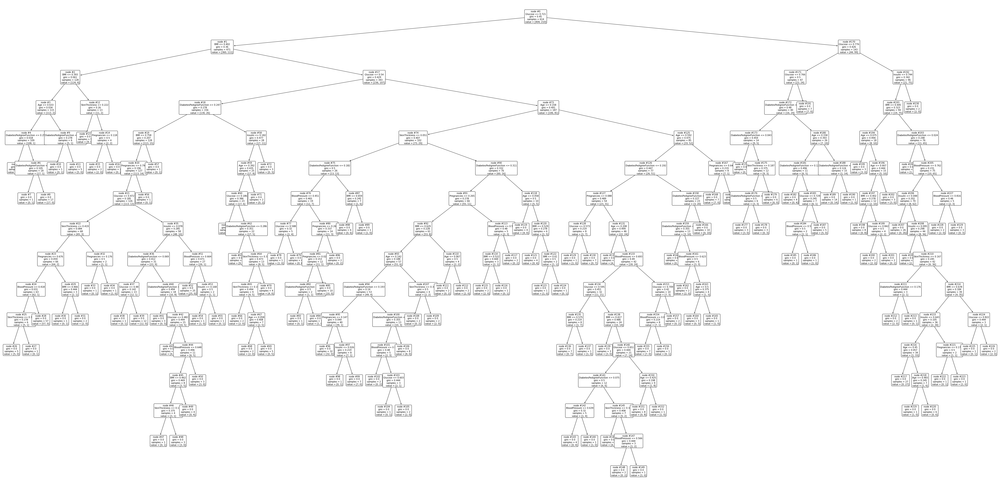

In [ ]:
#### Plot the dt tree.
from sklearn import tree
import matplotlib.pyplot as plt
plt.figure(figsize=(80,40))
tree.plot_tree(models['dt'], fontsize=10, feature_names=df_info.feature_names, node_ids=True,rounded=True )
#If you need to colored the class >> filled=True

### Specify the original input and counterfactual 

In [ ]:
#### retrieve the input and cf vectors.
dice_input = input_and_cf['input'].loc[0]
dice_cf = input_and_cf['cf'].loc[0]


In [ ]:
#input_and_cf["input"].loc[max_l2_instance.index]

#max_l2_example = input_and_cf["cf"].loc[max_l2_instance.index]

#decisions, pred, leaf_id = rules.get_decision_process(np.array(input_and_cf["input"].iloc[max_l2_instance.index]).reshape(1, -1), models['dt'], df_info.feature_names)
#print(leaf_id)

#### Decision path

In [ ]:
#### Present the decision path
#tree_path = extract_decision_path(clf, graph, dice_input)
#tree_path

In [ ]:
#### Present the decision path
#tree_path = extract_decision_path(clf, graph, dice_cf)
#tree_path

In [ ]:
#decisions, pred, leaf_id = rules.get_decision_process(np.array(dice_cf).reshape(1, -1), models['dt'], df_info.feature_names)
#print(leaf_id)


In [ ]:
#decisions, pred, leaf_id = rules.get_decision_process(np.array(dice_cf).reshape(1, -1), models['dt'], df_info.feature_names)
#print(leaf_id)

## This step is for generating a decision path: Strart from the Max_L2

In [ ]:
#lable_str = graph.get_node_list()[2].get_attributes()['label']
#feature_value_str = (lable_str.split("<br/>")[0]).replace('<','')
#feature_name = feature_value_str.split(" ")[0]
#feature_value = float(feature_value_str.split(" ")[-1])
#original_value = get_original_value(df_info.scaler, feature_name , feature_value)
#lable_str.replace(feature_value_str, ' '.join([*(feature_value_str.split(' '))[:-1],f'{original_value:.2f}']))

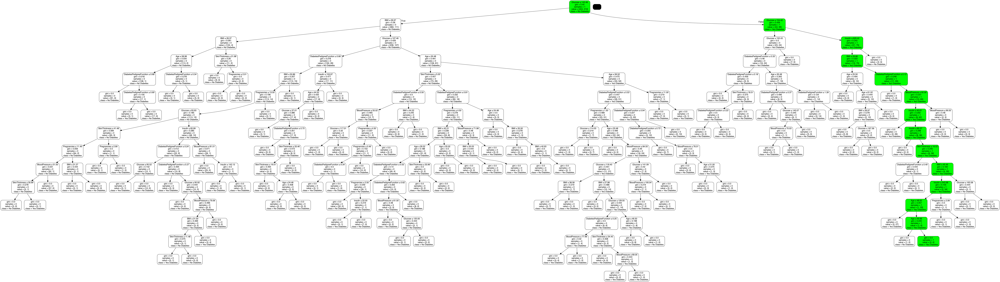

In [ ]:
INDX = 0
exp_type = "true_positives"
#instance = new_min_l2_instance_instance_arr
from copy import deepcopy

#img = visualize_decision_tree_path( clf, graph, dice_input, INDX, 'true_positives', filepath)
#img


img = visualize_decision_tree_path( clf, export_decision_tree(clf, class_names, dataset_name, filepath) , dice_input, INDX, 'true_positives', filepath)
img




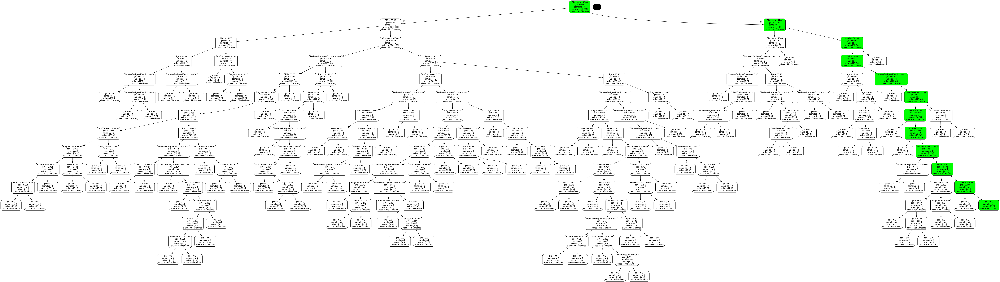

In [ ]:
#exp_type = "L2_max"
INDX = 0
#instance = instance
#exp_type = "true_positives"
#instance = new_min_l2_instance_instance_arr

img = visualize_decision_tree_path( clf, export_decision_tree(clf, class_names, dataset_name, filepath), dice_cf, INDX, 'true_positives', filepath)
img

In [ ]:
viz = dtreeviz(clf, 
               x_data=X_train,
               y_data=y_train,
               target_name='target',
               feature_names=df_info.feature_names, 
               class_names=class_names,
               title="Decison Tree - Diabetes with decision path",
               #orientation="LR", 
               #X=arr,
               X=dice_input
               #X=X_test[0]
               )
viz.view()
viz

In [ ]:
viz = dtreeviz(clf, 
               x_data=X_train,
               y_data=y_train,
               target_name='target',
               feature_names=df_info.feature_names, 
               class_names=class_names,
               title="Decison Tree - Diabetes with decision path",
               #orientation="LR", 
               #X=arr,
               X=dice_cf
               #X=X_test[0]
               )
viz.view()
viz

In [ ]:
##reference
#https://towardsdatascience.com/a-better-way-to-visualize-decision-trees-with-the-dtreeviz-library-758994cdf05e

### Get a classified models (with color)

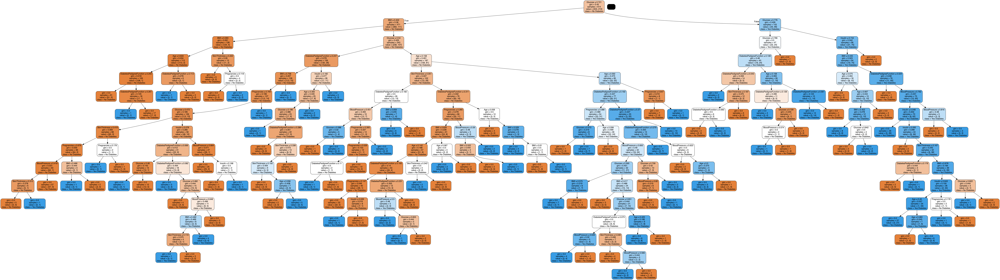

In [ ]:
graph = export_decision_tree(clf, class_names, dataset_name, filepath) 
Image(graph.create_png())

In [ ]:
input_and_cf

{'input':      Pregnancies   Glucose  BloodPressure  SkinThickness   Insulin       BMI  \
 0       0.411765  0.909548       0.688525       0.212121  0.226950  0.535022   
 1       0.411765  0.909548       0.688525       0.212121  0.226950  0.535022   
 2       0.411765  0.909548       0.688525       0.212121  0.226950  0.535022   
 3       0.411765  0.909548       0.688525       0.212121  0.226950  0.535022   
 4       0.411765  0.909548       0.688525       0.212121  0.226950  0.535022   
 ..           ...       ...            ...            ...       ...       ...   
 96      0.000000  0.502513       0.721311       0.606061  0.130024  0.697466   
 97      0.000000  0.502513       0.721311       0.606061  0.130024  0.697466   
 98      0.000000  0.502513       0.721311       0.606061  0.130024  0.697466   
 99      0.000000  0.502513       0.721311       0.606061  0.130024  0.697466   
 100          NaN       NaN            NaN            NaN       NaN       NaN   
 
      DiabetesPed

#### Histogram & pie with 5 max_depth

In [ ]:
#classifier = tree.DecisionTreeClassifier(max_depth=5)  # limit depth of tree

#classifier.fit(X_train, y_train)

#viz = dtreeviz(classifier, 
#               X_train, 
#               y_train,
#              target_name='class',
#               feature_names=df_info.feature_names, 
#               class_names=class_names  # need class_names for classifier
#              )  
              
#viz.view() 
#viz

#### Get the histogram & pie chart

In [ ]:
viz = dtreeviz(clf, 
               x_data=X_train,
               y_data=y_train,
               target_name='target',
               feature_names=df_info.feature_names, 
               class_names=class_names,
               title="Decison Tree - Diabetes with decision path",
               #orientation="LR", 
               X=dice_input
               )

viz

In [ ]:
viz = dtreeviz(clf, 
               x_data=X_train,
               y_data=y_train,
               target_name='target',
               feature_names=df_info.feature_names, 
               class_names=class_names,
               title="Decison Tree - Diabetes with decision path",
               #orientation="LR", 
               X=dice_cf
               )

viz

#### DiCE regression graph

In [ ]:
# fir the regressor
#reg = tree.DecisionTreeRegressor(max_depth=5, random_state=42)
reg = tree.DecisionTreeRegressor(random_state=42)
reg.fit(X_train, y_train)

# plot the tree
viz = dtreeviz(reg,
               x_data=X_train,
               y_data=y_train,

               target_name='target',
               feature_names=df_info.feature_names,
               title="Decision Tree - Diabetes",
               show_node_labels = True,
               X=dice_input
               )
viz.view()
viz

In [ ]:
# fir the regressor
#reg = tree.DecisionTreeRegressor(max_depth=5, random_state=42)
reg = tree.DecisionTreeRegressor(random_state=42)
reg.fit(X_train, y_train)

# plot the tree
viz = dtreeviz(reg,
               x_data=X_train,
               y_data=y_train,

               target_name='target',
               feature_names=df_info.feature_names,
               title="Decision Tree - Diabetes",
               show_node_labels = True,
               X=dice_cf
               )
viz.view()
viz

In [ ]:
viz = dtreeviz(models['dt'], X_train, y_train,
                target_name="target",
                feature_names=df_info.feature_names)
viz

In [ ]:
viz = dtreeviz(clf, 
               x_data=X_train,
               y_data=y_train,
               target_name='target',
               feature_names=df_info.feature_names, 
               class_names=class_names,
               title="Decison Tree - Diabetes with decision path",
               #orientation="LR", 
               X=X_test[0])  
viz

In [ ]:
# fir the regressor
#reg = tree.DecisionTreeRegressor(max_depth=5, random_state=42)
reg = tree.DecisionTreeRegressor(random_state=42)
reg.fit(X_train, y_train)

# plot the tree
viz = dtreeviz(reg,
               x_data=X_train,
               y_data=y_train,

               target_name='target',
               feature_names=df_info.feature_names,
               title="Decision Tree - Diabetes",
               show_node_labels = True)
viz.view()
viz

In [ ]:
#Evaluation- L2 cf result (Max)
max_l2_instance = dice_dt[dice_dt.L2.eq(dice_dt.L2.max())]
#Evaluation- L2 cf result (Min)
min_l2_instance = dice_dt[dice_dt.L2.eq(dice_dt.L2.min())]

In [ ]:
import numpy as np
mylist_max = []

for dic in max_l2_instance_instance[:]:
    name = dic.get('threshold')
    mylist_max.append(name)
print(mylist_max)


max_l2_instance_instance_arr = np.array(mylist_max)

#arr_1 = np.array(mylist)
#arr_1
new_min_l2_instance_instance_arr = np.append (min_l2_instance_instance_arr, [0.15833334])
print(new_min_l2_instance_instance_arr)
new_max_l2_instance_instance_arr = np.append (max_l2_instance_instance_arr, [0.15833334])
print(new_max_l2_instance_instance_arr)

NameError: name 'max_l2_instance_instance' is not defined

### Inverse function

In [ ]:
def get_location(scaler, col):
    if col in scaler.feature_names_in_:
        return np.where(scaler.feature_names_in_ == col)[0]
    
    else:
        raise Exception(f"Column [{col}] not a feature in this scaler, scaler features: {scaler.feature_names_in_}")


def get_scaled_value(scaler, col, X):
    loc=get_location(scaler, col)

    X *= scaler.scale_[loc]
    X += scaler.min_[loc]

    if scaler.clip:
        np.clip(X, scaler.feature_range[0][loc], scaler.feature_range[1][loc], out=X)
    
    return X[0]


def get_original_value(scaler, col, X):
    loc = get_location(scaler, col)

    X -= scaler.min_[loc]
    X /= scaler.scale_[loc]

    return X[0]

In [ ]:
test4 = get_scaled_value(df_info.scaler, 'Glucose', 0.721)
test4

0.0036231155778894473

In [ ]:
test5 = get_original_value(df_info.scaler, 'Glucose', 0.721)
test5

143.47899999999998

In [ ]:
clf=models['dt']
class_names = ["No", "Yes"]
viz = dtreeviz(clf, 
               x_data=X_train,
               y_data=y_train,
               target_name='target',
               # feature_names=df_info.feature_names,
               feature_names=df_info.ohe_feature_names, 
               class_names=class_names,
               title="Decison Tree - COMPAS with decision path",
               # orientation="LR", 
               # fancy=False,
               # X=arr,
               X=dice_cf, # B1. value not acceptable by this function.
               # scale=.3,
               show_just_path = True,
               max_X_features_TD= 1,
               max_X_features_LR=1,
               # depth_range_to_display=(0, 3)
               # X=X_test[0]
               
               )

## Seems this one work.         
viz.save("./testing-1.svg")